In [1]:
# Copyright (c) 2025 Devansh R Agrawal - All rights reserved.

In [2]:
ENV["JULIA_PKG_PRECOMPILE_AUTO"]=0

0

In [3]:
] activate .

  Activating project at `~/research2/14_2025_winter/gatekeeper-formation-flight/GatekeeperFormationFlight/examples`


In [4]:
] st

Status `~/research2/14_2025_winter/gatekeeper-formation-flight/GatekeeperFormationFlight/examples/Project.toml`
  [459566f4] DiffEqCallbacks v4.4.0
  [c4b27c1d] Dubins v1.2.1 `~/research2/14_2025_winter/Dubins.jl`
⌅ [f6369f11] ForwardDiff v0.10.38
  [c276d96c] GatekeeperFormationFlight v1.0.0-DEV `..`
  [20393b10] InfiniteOpt v0.5.9
  [a98d9a8b] Interpolations v0.15.1
  [b6b21f68] Ipopt v1.9.0
  [ab2f91bb] OSQP v0.8.1
  [1dea7af3] OrdinaryDiffEq v6.93.0
  [91a5bcdd] Plots v1.40.13
  [90137ffa] StaticArrays v1.9.13
  [37e2e46d] LinearAlgebra v1.11.0
  [9a3f8284] Random v1.11.0
  [2f01184e] SparseArrays v1.11.0
Info Packages marked with ⌅ have new versions available but compatibility constraints restrict them from upgrading. To see why use `status --outdated`


In [5]:
using GatekeeperFormationFlight
using Plots, LinearAlgebra, StaticArrays, Random
using Dubins

GFF = GatekeeperFormationFlight


GatekeeperFormationFlight

In [6]:
# wez = Cbez(; x=0.5, y=0.5, ψ = 2π * rand(), R=0.15, t=0.15, v=1.0)
# wez = Cbez(; x=0.5, y=0.5, ψ = 2π * rand(), R = rand(), t=rand(), v=rand(), μ=rand())
# wez2 = Cardioid(0.5, 0.5)

wez = Cbez(rand(), rand(), 2π*rand())

Cbez{Float64}(0.1318179723851438, 0.1019610878860221, 2.7260451930505383, 0.9, 0.25, 1.0, 0.1, 0.1)

In [7]:
robot = Robot(0.0,0.0,π/4)

Robot{Float64}(0.0, 0.0, 0.7853981633974483)

┌ Plots | Warning ] : Keyword argument markerstrokestyle not supported with Plots.GRBackend().  Choose from: annotationcolor, annotationfontfamily, annotationfontsize, annotationhalign, annotationrotation, annotations, annotationvalign, arrow, aspect_ratio, axis, background_color, background_color_inside, background_color_outside, background_color_subplot, bar_width, bins, bottom_margin, camera, clims, color_palette, colorbar, colorbar_entry, colorbar_scale, colorbar_title, colorbar_titlefont, colorbar_titlefontcolor, colorbar_titlefontrotation, colorbar_titlefontsize, connections, contour_labels, discrete_values, fill, fill_z, fillalpha, fillcolor, fillrange, fillstyle, flip, fontfamily, fontfamily_subplot, foreground_color, foreground_color_axis, foreground_color_border, foreground_color_grid, foreground_color_subplot, foreground_color_text, formatter, framestyle, grid, gridalpha, gridlinewidth, gridstyle, group, guide, guidefont, guidefontcolor, guidefontfamily, guidefonthalign, gui

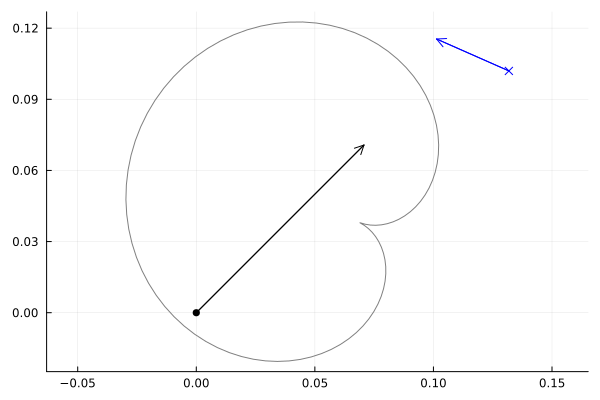

In [8]:
plot()
plot!(robot)
plot!(wez, robot)
# plot!(wez2, robot)

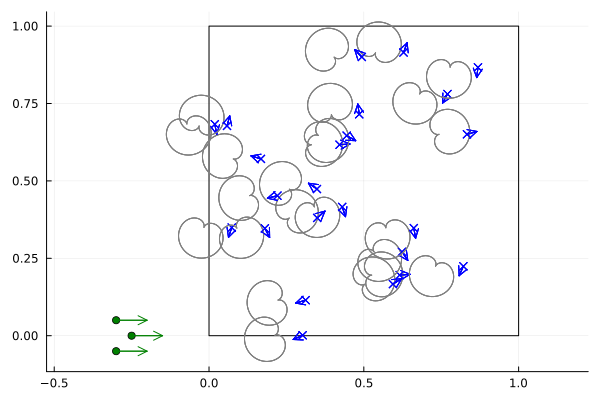

In [9]:

# create an environment
function create_random_scenario(N_wezes = 24)
    wezes_1 = [Cbez(
            rand(), 
            rand(),
            2π*rand(),
        ) for i = 1:N_wezes/2]

    wezes_2 = [Cbez(
            0.5 + 0.2 * randn(),
            0.5 + 0.2 * randn(),
            2π*rand(),
        ) for i = 1:N_wezes/2]
    
    # wezes_2 = [Cbez(0.5 + 0.2 * randn(), 0.5 + 0.2 * randn(), 2π*rand(), R= 0.05, t=0.05) for i = 1:N_wezes/2]
    wezes = vcat(wezes_1, wezes_2)
    return wezes
end

# change the seed to get different environments
# seed = 27182818 with 24 wezes is a good looking env.
# seed = 1, N = 24 is good
# seed = 2, N = 24 is good
# seed = 2718, N = 24 is good
# seed = 271828, N = 24 is good
Random.seed!(1)
wezes = create_random_scenario(24)

# create a set of robots
leader_robot = Robot(-0.25, 0.0, 0.0)
follower_robots = [Robot(-0.3, -0.05, 0.0), Robot(-0.3, 0.05, 0.0)]
robots = vcat(leader_robot, follower_robots...)

plotscenario(wezes, robots)

In [10]:

# plan a path for the leader using RRT*
domain = ((@SVector [0, 0, -1.0 * π]), (@SVector [1, 1, 1.0 * π]))
turning_radius = 0.1
rrt_problem = DubinsRRTProblem(domain, turning_radius, wezes)


DubinsRRTProblem{Float64, Cbez{Float64}}(([0.0, 0.0, -3.141592653589793], [1.0, 1.0, 3.141592653589793]), 0.1, Cbez{Float64}[Cbez{Float64}(0.07336635446929285, 0.34924148955718615, 4.390857551235271, 0.9, 0.25, 1.0, 0.1, 0.1), Cbez{Float64}(0.6282647403425017, 0.9149290036628314, 1.2114491231010585, 0.9, 0.25, 1.0, 0.1, 0.1), Cbez{Float64}(0.7701803478856664, 0.7805192636751863, 4.211392655002153, 0.9, 0.25, 1.0, 0.1, 0.1), Cbez{Float64}(0.16771210647092682, 0.5710874493423871, 2.8450802625834792, 0.9, 0.25, 1.0, 0.1, 0.1), Cbez{Float64}(0.30232547191787174, 0.0013502779247226426, 3.5627148125272763, 0.9, 0.25, 1.0, 0.1, 0.1), Cbez{Float64}(0.6159379234562881, 0.19573857852575793, 0.07830071569449379, 0.9, 0.25, 1.0, 0.1, 0.1), Cbez{Float64}(0.3119923865097316, 0.11479916823306191, 3.430925227253167, 0.9, 0.25, 1.0, 0.1, 0.1), Cbez{Float64}(0.6232150941621899, 0.2708693898950604, 5.310435222511279, 0.9, 0.25, 1.0, 0.1, 0.1), Cbez{Float64}(0.49359045543272007, 0.9003405842788204, 2.3383

In [237]:
# start the tree with the root node
nodes = [Node(SVector(0, 0, 0.0))]

# add 1000 nodes to the tree
@time nodes = rrt_star(rrt_problem, nodes, 2000)

# see if there is a path 
success_code, waypoints = get_best_path(rrt_problem, nodes, @SVector [1.0, 1.0, 0])

 13.008932 seconds (30.36 M allocations: 791.903 MiB, 1.48% gc time)


(true, SVector{3, Float64}[[0.0, 0.0, 0.0], [0.31475982534812647, 0.2343128690338056, 0.6037532431391888], [0.47951967488252334, 0.3242363174640567, 0.7416720448930447], [0.6376664661061257, 0.6918140550018317, 1.5871629533608553], [0.7359865205479044, 0.8508641674067454, 0.9695843375768528], [1.0, 1.0, 0.0]])

In [12]:
@assert success_code

# prepend and append the start and the goal
waypoints = [SVector(leader_robot), waypoints..., SVector(1.25, 1, 0.0)]

path = DubinsPath[]
# add all the waypoints to the path
for i = 2:length(waypoints)
    e, p = dubins_shortest_path(waypoints[i-1], waypoints[i], rrt_problem.turning_radius)
    @assert e == Dubins.EDUBOK
    push!(path, p)
end

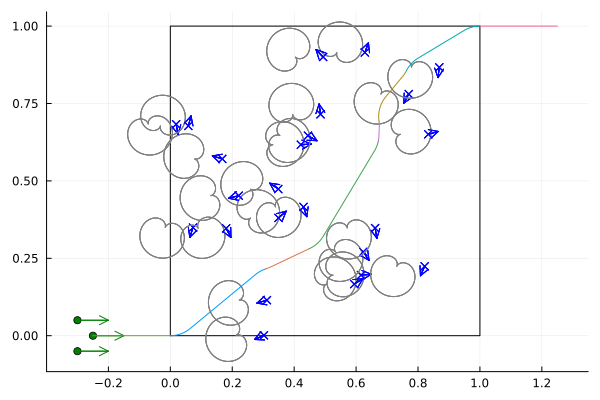

In [13]:
plotscenario(wezes, robots)
for p in path
    plot!(p)
end
plot!()

[ Plots | Info ] : Saved animation to /Users/devanshagrawal/research2/14_2025_winter/gatekeeper-formation-flight/GatekeeperFormationFlight/examples/tmp.gif


Plots.AnimatedGif("/Users/devanshagrawal/research2/14_2025_winter/gatekeeper-formation-flight/GatekeeperFormationFlight/examples/tmp.gif")
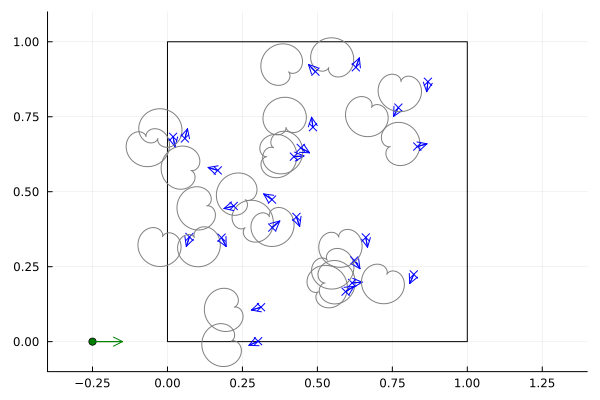

In [14]:
@gif for t in range(0, total_path_length(path), length=120)
    r = Robot(get_reference_state_and_input(path, t)[1])

    plotscenario(wezes, [r])
    xlims!(-0.4, 1.4)
    ylims!(-0.1, 1.1)
end

## solve for the trajectory using gatekeeper

In [15]:
offsets = [SVector(robot) - SVector(leader_robot) for robot in robots]

# For all three robots, we can define the set of problems as 
gk_problems = [
    GatekeeperProblem(;
        wezes = wezes,
        reference_path = path,
        offset = offsets[i],
        switch_step_size = 2e-3,
        reconnection_step_size = 0.01,
        max_Ts_horizon = 0.5,
        integration_max_step_size = 1e-3,
        collision_check_step_size = 1e-3,
    ) for i = 1:length(robots)
]


3-element Vector{GatekeeperProblem{Vector{Cbez{Float64}}, Vector{DubinsPath}, SVector{3, Float64}, Float64}}:
 Gatekeeper Problem(|wezes|: 24, offset: [0.0, 0.0, 0.0], turning radius: 0.1)
 Gatekeeper Problem(|wezes|: 24, offset: [-0.04999999999999999, -0.05, 0.0], turning radius: 0.1)
 Gatekeeper Problem(|wezes|: 24, offset: [-0.04999999999999999, 0.05, 0.0], turning radius: 0.1)

In [223]:

# We can now `solve` the problems and plot the solutions:
tspan = [0.0, total_path_length(path)]
@time gk_solutions = [
    simulate_closed_loop_gatekeeper(SVector(robots[i]), tspan, gk_problems[i]) for
    i = 1:length(robots)
]


  3.613936 seconds (11.21 M allocations: 327.894 MiB, 13.29% gc time, 15.34% compilation time: 69% of which was recompilation)


3-element Vector{SciMLBase.ODESolution{Float64, 2, Vector{Vector{Float64}}, Nothing, Nothing, Vector{Float64}, Vector{Vector{Vector{Float64}}}, Nothing, SciMLBase.ODEProblem{Vector{Float64}, Tuple{Float64, Float64}, true, Vector{Any}, SciMLBase.ODEFunction{true, SciMLBase.AutoSpecialize, FunctionWrappersWrappers.FunctionWrappersWrapper{Tuple{FunctionWrappers.FunctionWrapper{Nothing, Tuple{Vector{Float64}, Vector{Float64}, Vector{Any}, Float64}}, FunctionWrappers.FunctionWrapper{Nothing, Tuple{Vector{ForwardDiff.Dual{ForwardDiff.Tag{DiffEqBase.OrdinaryDiffEqTag, Float64}, Float64, 1}}, Vector{ForwardDiff.Dual{ForwardDiff.Tag{DiffEqBase.OrdinaryDiffEqTag, Float64}, Float64, 1}}, Vector{Any}, Float64}}, FunctionWrappers.FunctionWrapper{Nothing, Tuple{Vector{ForwardDiff.Dual{ForwardDiff.Tag{DiffEqBase.OrdinaryDiffEqTag, Float64}, Float64, 1}}, Vector{Float64}, Vector{Any}, ForwardDiff.Dual{ForwardDiff.Tag{DiffEqBase.OrdinaryDiffEqTag, Float64}, Float64, 1}}}, FunctionWrappers.FunctionWrapp

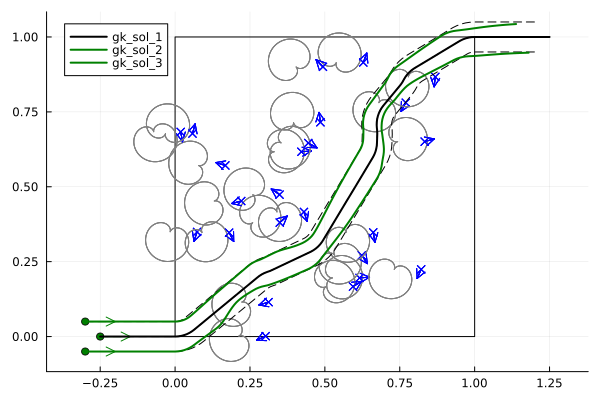

In [17]:

Tmax = total_path_length(path)

# plot reference path
plotscenario(wezes, robots)
# plot offset path
for i = 1:length(robots)
    plot!(
        τ -> get_reference_state_and_input(path, τ, offsets[i])[1][1],
        τ -> get_reference_state_and_input(path, τ, offsets[i])[1][2],
        0.0,
        Tmax,
        linestyle = :dash,
        label = false,
        linecolor = :black,
    )
end
# plot the gk solution
for i = 1:length(robots)
    plot!(
        t -> gk_solutions[i](t)[1],
        t -> gk_solutions[i](t)[2],
        0.0,
        Tmax,
        label = "gk_sol_$(i)",
        color = (i == 1 ? :black : :green),
        linewidth = 2,
    )
end

plot!(aspect_ratio = :equal)


[ Plots | Info ] : Saved animation to /Users/devanshagrawal/research2/14_2025_winter/gatekeeper-formation-flight/GatekeeperFormationFlight/examples/gatekeeper.gif


Plots.AnimatedGif("/Users/devanshagrawal/research2/14_2025_winter/gatekeeper-formation-flight/GatekeeperFormationFlight/examples/gatekeeper.gif")
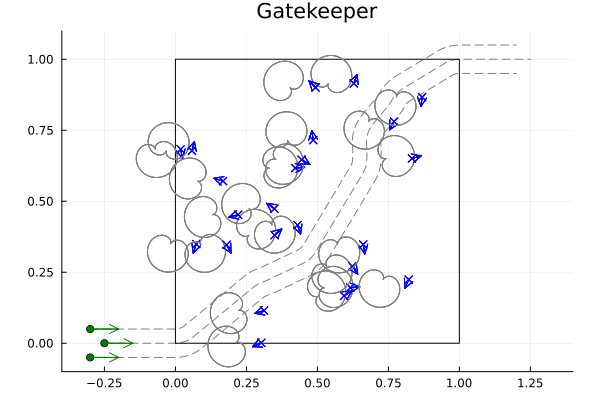

In [18]:
# Finally, lets animate the solutions:
anim_gk = @animate for t in range(0, Tmax, length=120)

    # grab the states
    robots_ = [Robot(gk_solutions[i](t)) for i=1:length(gk_solutions)]

    # start the plot
    plot()

    # plot the reference paths
    for i=1:3
        plot!(
            τ -> get_reference_state_and_input(path, τ, offsets[i])[1][1],
            τ -> get_reference_state_and_input(path, τ, offsets[i])[1][2],
            0, Tmax;
            label=false, color=:gray, linestyle=:dash)
    end

    # plot the trace of the robots upto this point of time
    for i=1:3
        plot!(τ -> gk_solutions[i](τ)[1], τ -> gk_solutions[i](τ)[2], 0.0, t, label="gk_sol_$(i)", color=(i==1 ? :black : :green), linewidth=2)
    end

    # plot the current state of affairs
    plotscenario!(wezes, robots_)
    title!("Gatekeeper")
    plot!(legend=false)

    xlims!(-0.4, 1.4)
    ylims!(-0.1, 1.1)
end

gif(anim_gk, "gatekeeper.gif")

# solve trajectories using CBF-QP

The QP

$$
\begin{align}
\operatorname{minimize } \ & \Vert u - u_d \Vert ^2\\
\text{such that } \ & Lfh_1(x) + Lgh_1(x) u \geq -\alpha h_1(x)\\
& Lfh_2(x) + Lgh_2(x) u \geq -\alpha h_2(x)\\
& \vdots\\
& Lfh_N(x) + Lgh_N(x) u \geq -\alpha h_N(x)\\
& u \in \mathcal{U}
\end{align}
$$


in standard form is

$$
\begin{align}
\operatorname{minimize } \ & \frac{1}{2} u^T u - u_d^T u\\
&  
\begin{bmatrix}
-L_fh_1(x) - \alpha h_1(x) \\
-L_fh_2(x) - \alpha h_2(x) \\
\vdots\\
-L_fh_N(x) - \alpha h_N(x) \\
\end{bmatrix}
\leq
\begin{bmatrix}
L_gh_1(x) \\
L_gh_2(x) \\
\vdots \\
L_ghN(x)
\end{bmatrix}
u \leq 
\begin{bmatrix}
\infty\\
\infty\\
\vdots\\
\infty
\end{bmatrix}\\
& u \in \mathcal{U}
\end{align}
$$



and if the first is infeasible, we solve the relaxed one instead: 

$$
\begin{align}
\operatorname{minimize } \ & \frac{1}{2} \begin{bmatrix}u\\s\end{bmatrix}^T \begin{bmatrix}\epsilon \\ & \epsilon \\ && 1 \end{bmatrix} \begin{bmatrix} u \\ s \end{bmatrix} - \begin{bmatrix} u_d \\ 0\end{bmatrix}^T  \begin{bmatrix}u \\ s \end{bmatrix}\\
&  
\begin{bmatrix}
-L_fh_1(x) - \alpha h_1(x) \\
-L_fh_2(x) - \alpha h_2(x) \\
\vdots\\
-L_fh_N(x) - \alpha h_N(x) \\
\hline
0 \\
0 \\
\vdots \\
0
\end{bmatrix}
\leq
\begin{bmatrix}
L_gh_1(x) & 1 \\
L_gh_2(x) & & 1 \\
\vdots & & & \ddots \\
L_gh_N(x) & & &  & 1 \\
\hline
0 & 1\\
0 & & 1 \\ 
\vdots & & & \ddots \\
0 & & & & 1
\end{bmatrix}
\begin{bmatrix} u  \\ s \end{bmatrix} \leq 
\begin{bmatrix}
\infty\\
\infty\\
\vdots\\
\infty\\
\hline
\infty \\
\infty \\
\vdots \\
\infty
\end{bmatrix}\\
& u \in \mathcal{U}
\end{align}
$$

for $\epsilon = 10^{-5}$


In [19]:
include("cbf-qp.jl")

Main.CBFQP

In [20]:
offsets = [SVector(robot) - SVector(leader_robot) for robot in robots]

3-element Vector{SVector{3, Float64}}:
 [0.0, 0.0, 0.0]
 [-0.04999999999999999, -0.05, 0.0]
 [-0.04999999999999999, 0.05, 0.0]

In [21]:
cbf_probs = [CBFQP.CBFProblem(; 
    wezes = wezes, 
    reference_path = path,
    offset = offsets[i],
    α = 100.0
    )
    for i=1:length(robots)
]

3-element Vector{Main.CBFQP.CBFProblem{Vector{Cbez{Float64}}, Vector{DubinsPath}, SVector{3, Float64}, Float64}}:
 CBF Problem(|wezes|: 24, offset: [0.0, 0.0, 0.0], turning radius: 0.1)
 CBF Problem(|wezes|: 24, offset: [-0.04999999999999999, -0.05, 0.0], turning radius: 0.1)
 CBF Problem(|wezes|: 24, offset: [-0.04999999999999999, 0.05, 0.0], turning radius: 0.1)

In [224]:
tspan = (0, total_path_length(path))
@time cbf_sols = [
    CBFQP.simulate_closed_loop_cbf(SVector(robots[i]), tspan, cbf_probs[i])
    for i=1:length(robots)
    ]

  9.490922 seconds (20.47 M allocations: 1.560 GiB, 3.31% gc time, 1.38% compilation time: 49% of which was recompilation)


3-element Vector{SciMLBase.ODESolution{Float64, 2, Vector{Vector{Float64}}, Nothing, Nothing, Vector{Float64}, Vector{Vector{Vector{Float64}}}, Nothing, SciMLBase.ODEProblem{Vector{Float64}, Tuple{Float64, Float64}, true, Main.CBFQP.CBFProblem{Vector{Cbez{Float64}}, Vector{DubinsPath}, SVector{3, Float64}, Float64}, SciMLBase.ODEFunction{true, SciMLBase.AutoSpecialize, FunctionWrappersWrappers.FunctionWrappersWrapper{Tuple{FunctionWrappers.FunctionWrapper{Nothing, Tuple{Vector{Float64}, Vector{Float64}, Main.CBFQP.CBFProblem{Vector{Cbez{Float64}}, Vector{DubinsPath}, SVector{3, Float64}, Float64}, Float64}}, FunctionWrappers.FunctionWrapper{Nothing, Tuple{Vector{ForwardDiff.Dual{ForwardDiff.Tag{DiffEqBase.OrdinaryDiffEqTag, Float64}, Float64, 1}}, Vector{ForwardDiff.Dual{ForwardDiff.Tag{DiffEqBase.OrdinaryDiffEqTag, Float64}, Float64, 1}}, Main.CBFQP.CBFProblem{Vector{Cbez{Float64}}, Vector{DubinsPath}, SVector{3, Float64}, Float64}, Float64}}, FunctionWrappers.FunctionWrapper{Nothing,

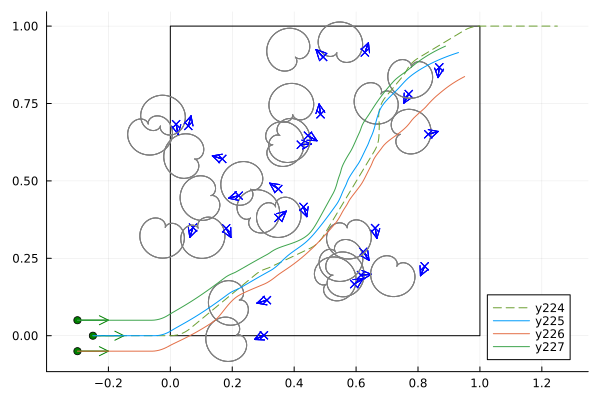

In [23]:
plotscenario(wezes, robots)
plot!(t->get_reference_state(path, t)[1], t->get_reference_state(path, t)[2], tspan..., linestyle=:dash) 
for i=1:length(robots)
    plot!(t -> cbf_sols[i](t)[1], t -> cbf_sols[i](t)[2], tspan...)
end
plot!()

[ Plots | Info ] : Saved animation to /Users/devanshagrawal/research2/14_2025_winter/gatekeeper-formation-flight/GatekeeperFormationFlight/examples/cbf.gif


Plots.AnimatedGif("/Users/devanshagrawal/research2/14_2025_winter/gatekeeper-formation-flight/GatekeeperFormationFlight/examples/cbf.gif")
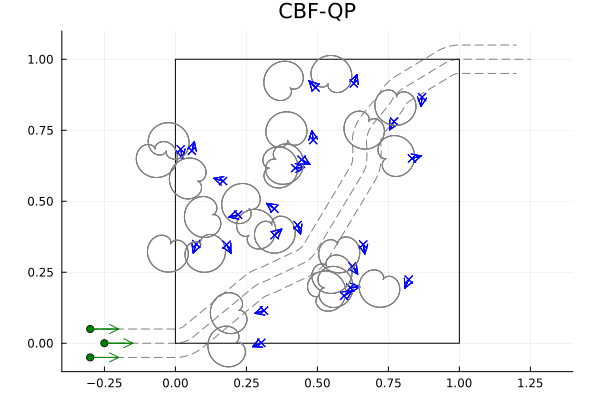

In [33]:
anim_cbf = @animate for t in range(tspan..., length=120)

    # grab the states
    robots_ = [Robot(cbf_sols[i](t)) for i=1:length(cbf_sols)]

    # start the plot
    plot()

    # plot the reference paths
    for i=1:3
        plot!(
            τ -> get_reference_state(path, τ, offsets[i])[1],
            τ -> get_reference_state(path, τ, offsets[i])[2],
            tspan...;
            label=false, color=:gray, linestyle=:dash)
    end

    # plot the trace of the robots upto this point of time
    for i=1:3
        plot!(τ -> cbf_sols[i](τ)[1], τ -> cbf_sols[i](τ)[2], 0.0, t, label="cbf_sol_$(i)", color=(i==1 ? :black : :purple), linewidth=2)
    end

    # plot the current state of affairs
    plotscenario!(wezes, robots_)
    title!("CBF-QP")
    plot!(legend=false)
    
    xlims!(-0.4, 1.4)
    ylims!(-0.1, 1.1)
end


gif(anim_cbf, "cbf.gif")

## Solve for trajectories using trajectory optimization

In [229]:
include("traj-opt.jl")

Main.TrajOpt

In [230]:
trajopt_probs = [
    TrajOpt.OptimalWezAvoidanceProblem(;
        wezes=wezes,
        reference_path=path,
        offset=offsets[i]
    )
    for i=1:length(robots)
];


In [231]:
trajopt_sols = Vector{Any}(undef, 3)
for i=1:3
    trajopt_sols[i] = nothing
end

In [236]:
@time trajopt_sols[1] = TrajOpt.simulate_closed_loop_trajopt(SVector(robots[1]), (0.0, total_path_length(path)), trajopt_probs[1])

*** starting to solve for initial_state = [-0.25, 0.0, 0.0]
resolving at t=0.0
resolving at t=0.2
resolving at t=0.4
 - replacing trajectory at t=0.4
resolving at t=0.6000000000000001
 - replacing trajectory at t=0.6000000000000001
resolving at t=0.8
resolving at t=1.0
resolving at t=1.2000000000000002
 - replacing trajectory at t=1.2000000000000002
resolving at t=1.4000000000000001
resolving at t=1.6
resolving at t=1.8
100.822730 seconds (573.03 M allocations: 24.652 GiB, 4.73% gc time)


retcode: Success
Interpolation: specialized 4th order "free" interpolation
t: 2012-element Vector{Float64}:
 0.0
 0.001
 0.002
 0.003
 0.004
 0.005
 0.006
 0.007
 0.008
 0.009000000000000001
 0.010000000000000002
 0.011000000000000003
 0.011896538249622432
 ⋮
 1.98299999999998
 1.9839999999999798
 1.9849999999999797
 1.9859999999999796
 1.9869999999999794
 1.9879999999999793
 1.9889999999999792
 1.9899999999999791
 1.990999999999979
 1.991999999999979
 1.9929999999999788
 1.993014106948842
u: 2012-element Vector{Vector{Float64}}:
 [-0.25, 0.0, 0.0]
 [-0.24907676420687158, 3.6953531838881504e-7, 0.0007760340900959505]
 [-0.24811871039467678, 1.4425278360462384e-6, 0.0014427050087498312]
 [-0.24713845696593104, 3.1405961552492536e-6, 0.002002584207754165]
 [-0.24614452698850764, 5.366300858185178e-6, 0.0024581953211350593]
 [-0.24514454888368506, 8.009738889511287e-6, 0.002812016614935043]
 [-0.24414455323005496, 1.0957163726376978e-5, 0.0030664831471565374]
 [-0.24314455820247854, 1.411

In [234]:
@time trajopt_sols[2] = TrajOpt.simulate_closed_loop_trajopt(SVector(robots[2]), (0.0, total_path_length(path)), trajopt_probs[2])

*** starting to solve for initial_state = [-0.3, -0.05, 0.0]
resolving at t=0.0
resolving at t=0.2
 - replacing trajectory at t=0.2
resolving at t=0.4
 - replacing trajectory at t=0.4
resolving at t=0.6000000000000001
resolving at t=0.8
resolving at t=1.0
 - replacing trajectory at t=1.0
resolving at t=1.2000000000000002
 - replacing trajectory at t=1.2000000000000002
resolving at t=1.4000000000000001
 - replacing trajectory at t=1.4000000000000001
resolving at t=1.6
 - replacing trajectory at t=1.6
resolving at t=1.8
 - replacing trajectory at t=1.8
100.917229 seconds (571.95 M allocations: 24.607 GiB, 5.56% gc time)


retcode: Success
Interpolation: specialized 4th order "free" interpolation
t: 2018-element Vector{Float64}:
 0.0
 0.001
 0.002
 0.003
 0.004
 0.005
 0.006
 0.007
 0.008
 0.009000000000000001
 0.010000000000000002
 0.011000000000000003
 0.011882882219182933
 ⋮
 1.98299999999998
 1.9839999999999798
 1.9849999999999797
 1.9859999999999796
 1.9869999999999794
 1.9879999999999793
 1.9889999999999792
 1.9899999999999791
 1.990999999999979
 1.991999999999979
 1.9929999999999788
 1.993014106948842
u: 2018-element Vector{Vector{Float64}}:
 [-0.3, -0.05, 0.0]
 [-0.29907735441304467, -0.04999998305011711, 5.43889583822228e-5]
 [-0.29812077381241814, -0.049999861900541925, 0.00021576801042742775]
 [-0.29714255373540666, -0.04999952888497081, 0.0004814942593701366]
 [-0.29615053333049746, -0.049998876932036855, 0.0008489732853297563]
 [-0.29515097636607945, -0.049997803176740525, 0.001315656076032587]
 [-0.29415097764239445, -0.049996213786238065, 0.0018790356654091688]
 [-0.29315098008061796, -0.0

In [235]:
@time trajopt_sols[3] = TrajOpt.simulate_closed_loop_trajopt(SVector(robots[3]), (0.0, total_path_length(path)), trajopt_probs[3])

*** starting to solve for initial_state = [-0.3, 0.05, 0.0]
resolving at t=0.0
resolving at t=0.2
resolving at t=0.4
 - replacing trajectory at t=0.4
resolving at t=0.6000000000000001
 - replacing trajectory at t=0.6000000000000001
resolving at t=0.8
 - replacing trajectory at t=0.8
resolving at t=1.0
 - replacing trajectory at t=1.0
resolving at t=1.2000000000000002
resolving at t=1.4000000000000001
resolving at t=1.6
 - replacing trajectory at t=1.6
resolving at t=1.8
 - replacing trajectory at t=1.8
100.913808 seconds (550.75 M allocations: 23.696 GiB, 5.37% gc time)


retcode: Success
Interpolation: specialized 4th order "free" interpolation
t: 2020-element Vector{Float64}:
 0.0
 0.001
 0.002
 0.003
 0.004
 0.005
 0.006
 0.007
 0.008
 0.009000000000000001
 0.010000000000000002
 0.011000000000000003
 0.011971097920922833
 ⋮
 1.98299999999998
 1.9839999999999798
 1.9849999999999797
 1.9859999999999796
 1.9869999999999794
 1.9879999999999793
 1.9889999999999792
 1.9899999999999791
 1.990999999999979
 1.991999999999979
 1.9929999999999788
 1.993014106948842
u: 2020-element Vector{Vector{Float64}}:
 [-0.3, 0.05, 0.0]
 [-0.2990782767398581, 0.05000002073199683, 6.662094661734473e-5]
 [-0.29812400030354724, 0.050000168753314075, 0.0002642929306666992]
 [-0.29714896473633695, 0.05000057531602318, 0.0005897771803550977]
 [-0.2961606890010105, 0.05000137085519508, 0.001039894356893336]
 [-0.2951641920656344, 0.050002682203259194, 0.0016115209942103566]
 [-0.29416420154555134, 0.05000462900024916, 0.0023015865078571903]
 [-0.2931642052036621, 0.050007323831698

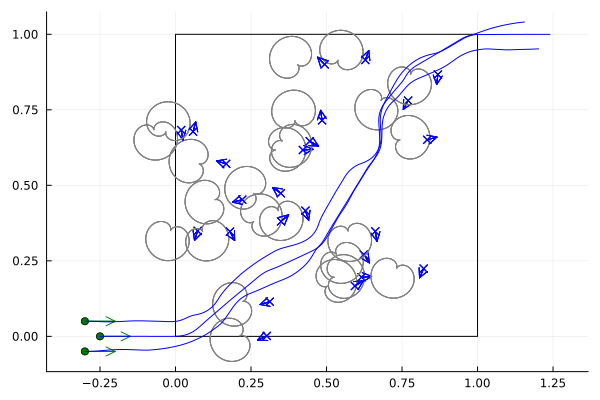

In [31]:
plotscenario(wezes, robots)

for i=1:length(robots)
    if !isnothing(trajopt_sols[i])
        plot!(
            τ -> trajopt_sols[i](τ)[1], τ -> trajopt_sols[i](τ)[2], 0, total_path_length(path), label=false, color=:blue)
    end
end

plot!()

In [32]:
gr()
traj_opt_anim = @animate for t=range(0.0, total_path_length(path), length=120)

    tf = total_path_length(path)
    
    # get the robots at the current time    
    robots_ = [(isnothing(trajopt_sols[i]) ? Robot(0.0,0.0,0.0) : Robot(trajopt_sols[i](t)) ) for i=1:length(robots)]
    
    # plot reference path
    plotscenario(wezes, robots_)
    plot!(aspect_ratio=:equal)
    for p in path
        plot!(p, color=:black, linestyle=:dash, label=false)
    end
    
    # plot the offset reference point
    for i=1:3
        ref_robot = Robot(get_reference_state(path, t, offsets[i])...)
        plot!(ref_robot; color=:gray, label=false)
    end

    # plot offset path
    for i=2:length(robots)
        plot!(
            τ-> get_reference_state(path, τ, offsets[i])[1], 
            τ-> get_reference_state(path, τ, offsets[i])[2], 
        0.0, tf, linestyle=:dash, color=:black, label=false)
    end
    
    # plot the trajectory so far
    for i=1:length(robots)
        if !isnothing(trajopt_sols[i])
            plot!(
                τ -> trajopt_sols[i](τ)[1], τ -> trajopt_sols[i](τ)[2], 0, t, label="optimal_control solution", color=(i==1 ? :black : :blue), linewidth=2
            )
        end
    end

    title!("Nonlinear Trajectory Optimization")
    plot!(xlims=(-0.4, 1.4), ylims=(-0.1, 1.1))
    plot!(label=false)
end



LoadError: UndefVarError: `save` not defined in `Main`
Suggestion: check for spelling errors or missing imports.

[ Plots | Info ] : Saved animation to /Users/devanshagrawal/research2/14_2025_winter/gatekeeper-formation-flight/GatekeeperFormationFlight/examples/trajopt.gif


Plots.AnimatedGif("/Users/devanshagrawal/research2/14_2025_winter/gatekeeper-formation-flight/GatekeeperFormationFlight/examples/trajopt.gif")
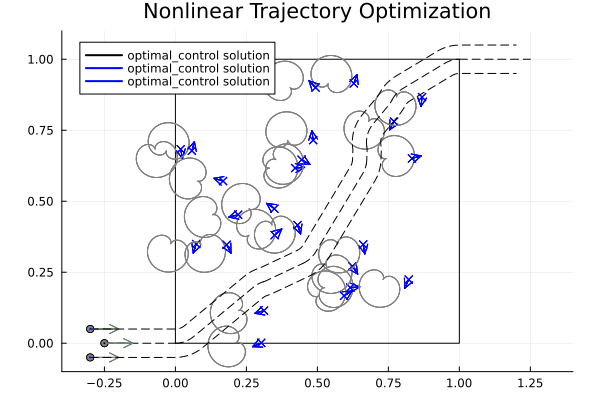

In [34]:
gif(traj_opt_anim, "trajopt.gif")

In [192]:
# make the paper plots
using LaTeXStrings

In [241]:


tspan = (0.0, total_path_length(path))


function create_paper_plot(sols; title="solution")
    # start the plot
    plot()

    tspan = extrema(sols[1].t)
    
    # create the wezes
    cxs = [wez.x for wez in wezes]
    cys = [wez.y for wez in wezes]
    scatter!(cxs, cys, marker=:x, color=:black)

    for wez in wezes
        circ_min = GFF.Circle(SVector(wez.x, wez.y), wez.μ * wez.R)
        circ_max = GFF.create_collision_region(wez)
        plot!(circ_min; color=:gray, opacity=0.4)
        plot!(circ_max; color=:gray, opacity=0.2, linestyle=:dash)
    end
    
    # create the bounding box
    plot!([0, 1, 1, 0, 0], [0, 0, 1, 1, 0], linecolor=:gray)
    
    # plot the reference path 
    for i=1:3
        plot!(τ -> get_reference_state(path, τ, offsets[i])[1], 
            τ -> get_reference_state(path, τ, offsets[i])[2], 
            tspan...,
            linecolor=:black, linestyle=:dash
            )
    end
    
    # plot the resulting trajectory
    for i=1:3
        ts = range(tspan..., length=1000)
        xs = [sols[i](τ) for τ in ts]
        color = [is_colliding(wezes, Robot(x)) ? :red : :green for x in xs]
        width = [is_colliding(wezes, Robot(x)) ? 4 : 3 for x in xs]
        plot!([x[1] for x in xs], [x[2] for x in xs], linecolor=(i==1 ? :black : color), linewidth=width)
    
    end
    
    
    plot!(title=title, legend=false)
    plot!(aspect_ratio=:equal)
    xlims!(-0.4, 1.4)
    ylims!(-0.1, 1.1)

    # for robot in robots
    #     plot!(robot)
    # end

    return plot!()
end   

create_paper_plot (generic function with 1 method)

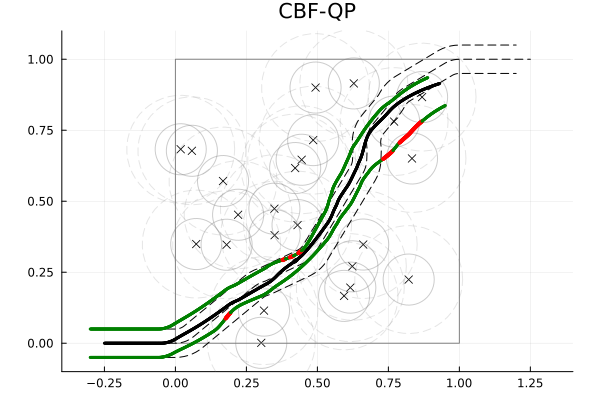

In [242]:
create_paper_plot(cbf_sols; title="CBF-QP")

savefig("cbf_qp.svg")
plot!()

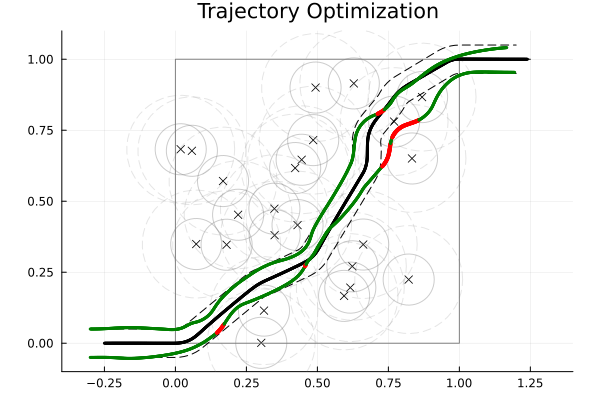

In [243]:
create_paper_plot(trajopt_sols; title="Trajectory Optimization")

savefig("trajopt.svg")
plot!()

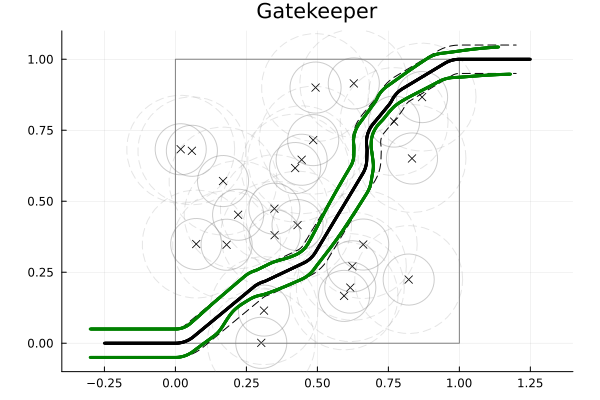

In [244]:
create_paper_plot(gk_solutions; title="Gatekeeper")
savefig("gk.svg")
plot!()

In [245]:
# plot the formation distance
function create_formation_distance_plot(sols)

    plot()
    hline!([0.0], linecolor=:black, linestyle=:dash, label=false)
    for i=1:3
        get_formation_dist(t, sol) = norm((get_reference_state(path, t, offsets[i]) - sols[i](t))[1:2])
        
        plot!(τ -> get_formation_dist(τ, sols[i]), 
            tspan..., label=false
            )
    end
    plot!()
    ylims!(-0.05, 0.4)
    
end

create_formation_distance_plot (generic function with 1 method)

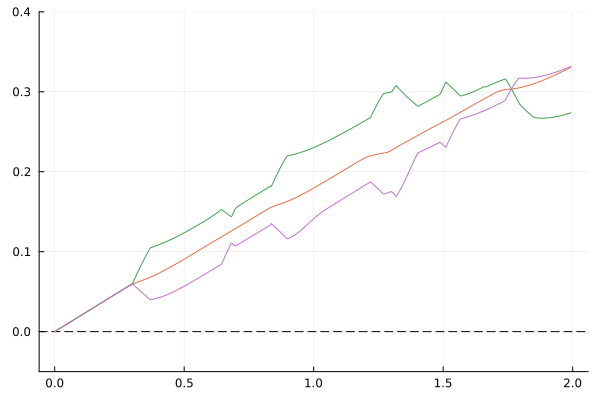

In [246]:
create_formation_distance_plot(cbf_sols)
# title!("CBF-QP")
savefig("suboptimality_cbf.svg")
plot!()

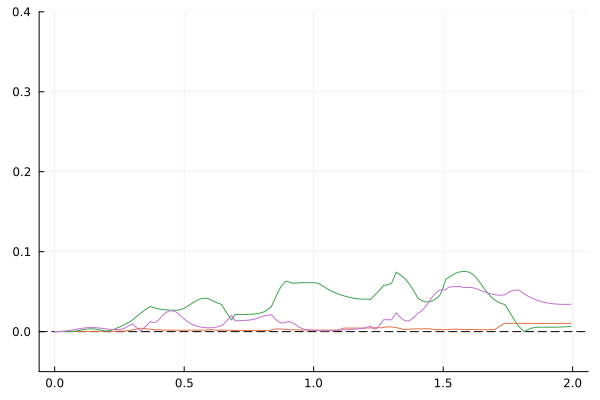

In [247]:
create_formation_distance_plot(trajopt_sols)
# title!("Traj Opt")
savefig("suboptimality_trajopt.svg")
plot!()

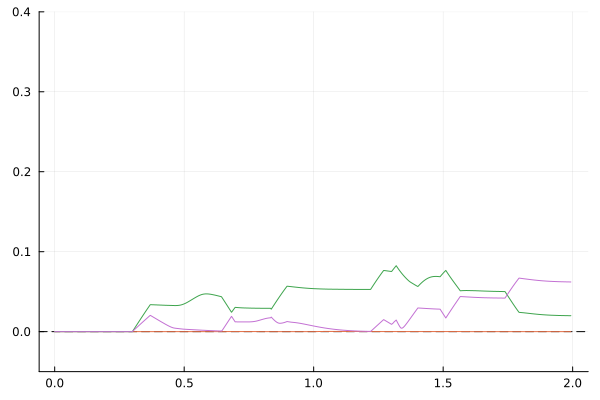

In [248]:
create_formation_distance_plot(gk_solutions)
# title!("GK")
savefig("suboptimality_gk.svg")
plot!()

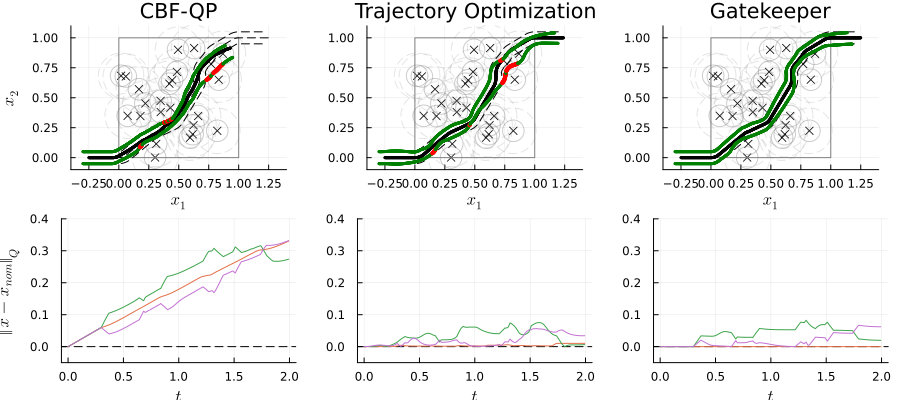

In [249]:
p1 = create_paper_plot(cbf_sols; title="CBF-QP")
xlabel!(L"x_1")
ylabel!(L"x_2")
p2 = create_paper_plot(trajopt_sols; title="Trajectory Optimization")
xlabel!(L"x_1")
p3 = create_paper_plot(gk_solutions; title="Gatekeeper")
xlabel!(L"x_1")

p4 = create_formation_distance_plot(cbf_sols)
xlabel!(L"t")
ylabel!(L"\Vert x - x_{\rm nom} \Vert_Q")
p5 = create_formation_distance_plot(trajopt_sols)
xlabel!(L"t")
p6 = create_formation_distance_plot(gk_solutions)
xlabel!(L"t")

plot(p1, p2, p3, p4, p5, p6, layout = (@layout [a b c; d e f]), size=(600*3/2, 400*2/2))




In [250]:
savefig("paper_fig.pdf")

"/Users/devanshagrawal/research2/14_2025_winter/gatekeeper-formation-flight/GatekeeperFormationFlight/examples/paper_fig.pdf"

In [418]:


# We can now `solve` the problems and plot the solutions:
tspans = [
    (0.0, 0.00), 
    (0.0, 0.6), 
    (0.0, 1.1), 
    (0.0, 1.8)
]

gk_partial_sols = [
    simulate_closed_loop_gatekeeper(SVector(robots[2]), tspans[i], gk_problems[2]) for
    i = 1:length(tspans)
]



4-element Vector{SciMLBase.ODESolution{Float64, 2, Vector{Vector{Float64}}, Nothing, Nothing, Vector{Float64}, Vector{Vector{Vector{Float64}}}, Nothing, SciMLBase.ODEProblem{Vector{Float64}, Tuple{Float64, Float64}, true, Vector{Any}, SciMLBase.ODEFunction{true, SciMLBase.AutoSpecialize, FunctionWrappersWrappers.FunctionWrappersWrapper{Tuple{FunctionWrappers.FunctionWrapper{Nothing, Tuple{Vector{Float64}, Vector{Float64}, Vector{Any}, Float64}}, FunctionWrappers.FunctionWrapper{Nothing, Tuple{Vector{ForwardDiff.Dual{ForwardDiff.Tag{DiffEqBase.OrdinaryDiffEqTag, Float64}, Float64, 1}}, Vector{ForwardDiff.Dual{ForwardDiff.Tag{DiffEqBase.OrdinaryDiffEqTag, Float64}, Float64, 1}}, Vector{Any}, Float64}}, FunctionWrappers.FunctionWrapper{Nothing, Tuple{Vector{ForwardDiff.Dual{ForwardDiff.Tag{DiffEqBase.OrdinaryDiffEqTag, Float64}, Float64, 1}}, Vector{Float64}, Vector{Any}, ForwardDiff.Dual{ForwardDiff.Tag{DiffEqBase.OrdinaryDiffEqTag, Float64}, Float64, 1}}}, FunctionWrappers.FunctionWrapp

In [419]:
[extrema(sol.t) for sol in gk_partial_sols]

4-element Vector{Tuple{Float64, Float64}}:
 (0.0, 0.0)
 (0.0, 0.6)
 (0.0, 1.1)
 (0.0, 1.8)

In [443]:

tspan = (0.0, total_path_length(path))

function plot_comp_traj!(comp_traj; t0 = nothing, kwargs...)
    # plot the nominal part
    plot!(
        τ -> comp_traj.nominal_trajectory(τ)[1], 
        τ -> comp_traj.nominal_trajectory(τ)[2], 
        (isnothing(t0) ? comp_traj.nominal_trajectory.t[1] : t0),
        comp_traj.switch_time;
        label=false, linecolor=:blue, linewidth=3, linestyle=:dash, kwargs...)

    # plot the backup part
    for p in comp_traj.backup_trajectory
        plot!(p, linecolor=:purple, linewidth=3, linestyle=:dash,label=false, kwargs...)
    end
end

function create_paper_partial_plot(sol; title="solution")
    # start the plot
    plot()

    sub_tspan = extrema(sol.t)
    @show sub_tspan
    
    # create the wezes
    # cxs = [wez.x for wez in wezes]
    # cys = [wez.y for wez in wezes]
    # scatter!(cxs, cys, marker=:x, color=:black)

    # for wez in wezes
    #     circ_min = GFF.Circle(SVector(wez.x, wez.y), wez.μ * wez.R)
    #     circ_max = GFF.create_collision_region(wez)
    #     plot!(circ_min; color=:gray, opacity=0.4)
    #     plot!(circ_max; color=:gray, opacity=0.2, linestyle=:dash)
    # end

    # grab the robots
    robot_ = Robot(sol(sub_tspan[2]))
    @show robot_
    leader_ = Robot(get_reference_state(path, sub_tspan[2]))

    # # plot the robot at the current time
    # plot!(robot_)

    # plot all the wezes and the robots at the current time
    for w in wezes
        plot!(w, robot_; color=:gray)
    end
    
    
    # create the bounding box
    plot!([0, 1, 1, 0, 0], [0, 0, 1, 1, 0], linecolor=:gray)
    
    # plot the reference path
    for i=1:2
        plot!(τ -> get_reference_state(path, τ, offsets[i])[1], 
            τ -> get_reference_state(path, τ, offsets[i])[2], 
            tspan...,
            linecolor=(i==1 ? :black : :green), linestyle=:dash
            )
    end

    # plot the leaders path 
    plot!(τ -> get_reference_state(path, τ)[1], 
            τ -> get_reference_state(path, τ)[2], 
            sub_tspan...,
            linecolor=:black, linewidth=3
            )
    
    # plot the closed-loop trajectory so far
    plot!( τ -> sol(τ)[1], τ -> sol(τ)[2], 0, sub_tspan[2], linecolor=:green, linewidth=3)

    # plot the composite trajectory
    plot_comp_traj!(sol.prob.p[2]; t0 = sub_tspan[2])
    
    plot!(title=title, legend=false)
    plot!(aspect_ratio=:equal)
    xlims!(-0.4, 1.4)
    ylims!(-0.1, 1.1)
    xticks!([0, 1.])
    yticks!([0, 1.])

    plot!(leader_, color=:black, linewidth=3, markersize=5)
    plot!(robot_, color=:green, linewidth=3, markersize=5)

    plot!(axis=false)
plot!(title="", grid=false)
    
    return plot!()
end   

create_paper_partial_plot (generic function with 1 method)

sub_tspan = (0.0, 0.0)
robot_ = Robot{Float64}(-0.3, -0.05, 0.0)
sub_tspan = (0.0, 0.6)
robot_ = Robot{Float64}(0.22676973593648228, 0.13254901047168519, 0.6173251343518329)
sub_tspan = (0.0, 1.1)
robot_ = Robot{Float64}(0.6092140141410479, 0.42651817437262424, 0.9902086524633569)
sub_tspan = (0.0, 1.8)
robot_ = Robot{Float64}(0.9875710168380205, 0.9360126099186955, 0.04993379788887804)


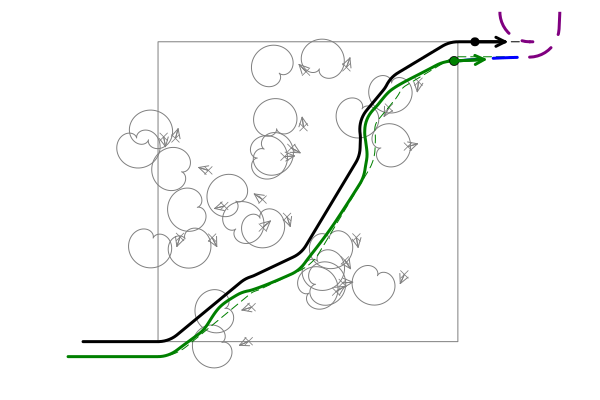

In [444]:
p1 = create_paper_partial_plot(gk_partial_sols[1]; title="1")

p2 = create_paper_partial_plot(gk_partial_sols[2]; title="2")
p3 = create_paper_partial_plot(gk_partial_sols[3]; title="1")
p4 = create_paper_partial_plot(gk_partial_sols[4]; title="1")

# plot(p1, p2, p3, p4, layout = (@layout [a b c d]), size=(600*2, 400/2))

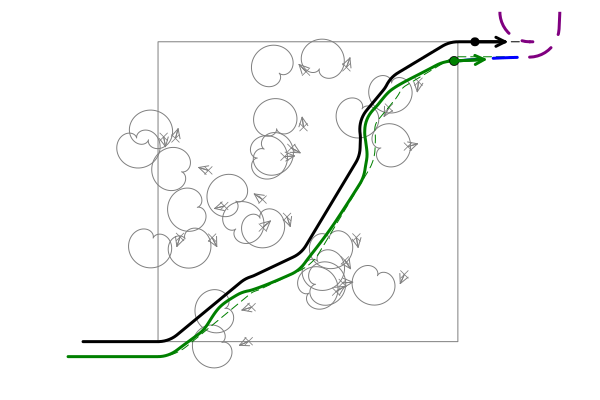

In [448]:
p4

In [450]:
savefig(p1, "gk_partial_1.svg")
savefig(p2, "gk_partial_2.svg")
savefig(p3, "gk_partial_3.svg")
savefig(p4, "gk_partial_4.svg")

"/Users/devanshagrawal/research2/14_2025_winter/gatekeeper-formation-flight/GatekeeperFormationFlight/examples/gk_partial_4.svg"